# Chord classifier


## Packages installation

In [ ]:
!wget https://repo.anaconda.com/miniconda/Miniconda3-latest-Linux-x86_64.sh
!chmod +x Miniconda3-latest-Linux-x86_64.sh
!bash ./Miniconda3-latest-Linux-x86_64.sh -b -f -p /usr/local

In [ ]:
import sys
sys.path.append('/usr/local/lib/python3.7/site-packages/')

In [ ]:
!conda install -c conda-forge ffmpeg libsndfile pandas numpy librosa matplotlib pytorch torchvision seaborn

In [ ]:
%pip install spleeter

In [ ]:
%pip install pandas numpy librosa matplotlib torch torchvision seaborn

In [ ]:
%pip install ray

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.8/64.8 MB 8.7 MB/s eta 0:00:00


## Data preprocessing

The purpose of preprocessing step, which is crucial for training the model, is to convert each chord represented as `wav` file into   spectrograms.


In [16]:
from pathlib import Path
import pandas as pd
import os

### Google Colab file management (no need to run outside Colab)

For usage of data in Google Colab, I mount my Google Drive and then copy files from it to the local instance to make processing faster.

In [ ]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive

Mounted at /gdrive
/gdrive


In [ ]:
os.chdir("/content")

In [ ]:
!cp -R "/gdrive/My Drive/chord_classifier/data" "data"

### Data exploration


In [30]:
data_dir = "data"
preprocessed_train_data_dir = Path(os.path.join(data_dir, "preprocessed", "train"))
preprocessed_test_data_dir = Path(os.path.join(data_dir, "preprocessed", "test"))
pretrained_models_dir = Path("pretrained_models")
preprocessed_train_data_dir.mkdir(parents=True, exist_ok=True)
preprocessed_test_data_dir.mkdir(parents=True, exist_ok=True)
pretrained_models_dir.mkdir(parents=True, exist_ok=True)


Show the number of chord recordings available for training and testing

In [18]:
train_data_dir = data_dir + "/Training"
test_data_dir = data_dir + "/Test"

def get_chord_counts(data_dir):
    chord_counts = {}

    for chord in os.listdir(data_dir):
        chord_path = os.path.join(data_dir, chord)
        if os.path.isdir(chord_path):
            chord_counts[chord] = len(os.listdir(chord_path))

    return chord_counts

In [19]:
print(f"Training data chord count {get_chord_counts(train_data_dir)}")
print(f"Testing data chord count {get_chord_counts(test_data_dir)}")

Training data chord count {'Am': 180, 'Bb': 180, 'Em': 180, 'G': 180, 'F': 180, 'Dm': 180, 'C': 180, 'Bdim': 180}
Testing data chord count {'Am': 40, 'Bb': 40, 'Em': 40, 'G': 40, 'F': 40, 'Dm': 40, 'C': 40, 'Bdim': 40}


Show the duration of sounds of chords. It ranges from 1.12 to 16.34 seconds with median about 5 seconds.

In [ ]:
import librosa

durations = []

for chord in os.listdir(train_data_dir):
    chord_path = os.path.join(train_data_dir, chord)
    if os.path.isdir(chord_path):
        for file in os.listdir(chord_path):
            file_path = os.path.join(chord_path, file)
            y, sr = librosa.load(file_path, sr=None)
            durations.append(librosa.get_duration(y=y, sr=sr))

durations_df = pd.DataFrame(durations, columns=['duration'])
durations_df.describe()

A little trick to create an image from a spectrogram with matplotlib and then save it.

In [126]:
import os
import librosa.display
import numpy as np

def create_spectrogram(audio_input, sr=None, save_path=None):
    # skip already existing sprectrogram
    if os.path.exists(save_path):
        print(f"Spectrogram  {save_path} already exists. Skipping.")
        return

    # Load the audio file if a path is provided, else use the provided audio data
    if isinstance(audio_input, str):
        y, sr = librosa.load(audio_input, sr=None)
    else:
        y = audio_input
        if sr is None:
            raise ValueError("Sampling rate must be provided with audio data")

    print(f"Creating spectrogram {save_path}")

    # Generate the Mel spectrogram
    S = librosa.feature.melspectrogram(y=y, sr=sr)
    S_dB = librosa.power_to_db(S, ref=np.max)

    # Plot and save the spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='mel')
    plt.axis('off')
    plt.xticks([]), plt.yticks([])
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0, format="jpg")
    plt.close()

    return S_dB


In [124]:
def convert_chords_to_spectrograms(source_dir, destination_dir):
    for chord in os.listdir(source_dir):
        chord_path = os.path.join(source_dir, chord)
        preprocessed_chord_path = os.path.join(destination_dir, chord)

        if not os.path.exists(preprocessed_chord_path):
            os.makedirs(preprocessed_chord_path)

        if os.path.isdir(chord_path):
            for file in os.listdir(chord_path):
                file_path = os.path.join(chord_path, file)

                y, sr = librosa.load(file_path, sr=None)

                # Calculate the number of samples per beat
                # 0.5 is the closest to average beat length so we will use this value for training
                beat_duration = 0.5
                samples_per_beat = int(beat_duration * sr)

                for i in range(0, len(y), samples_per_beat):
                    end_frame = i + samples_per_beat
                    if end_frame > len(y):
                        end_frame = len(y)  # Adjust the end frame for the last segment

                    segment = y[i:end_frame]
                    save_path = os.path.join(preprocessed_chord_path, os.path.splitext(file)[0] + "_" + str(i // samples_per_beat) + ".jpg")
                    # create spectrogram from a segment and save it to disk
                    create_spectrogram(segment, sr, save_path)


Convert train and test data. This will take a few minutes.


In [ ]:
convert_chords_to_spectrograms(train_data_dir, preprocessed_train_data_dir)
convert_chords_to_spectrograms(test_data_dir, preprocessed_test_data_dir)

Let's check the number of generated files.

In [ ]:
print(f"Training data chord count {get_chord_counts(preprocessed_train_data_dir)}")
print(f"Testing data chord count {get_chord_counts(preprocessed_test_data_dir)}")

An example of a spectrogram

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

image_path = os.path.join(preprocessed_train_data_dir, 'Am', 'Am_acousticguitar_Mari_1_0.jpg')

img = mpimg.imread(image_path)

# Display the image
plt.imshow(img)
plt.axis('off')
plt.show()

## Track splitting


In [119]:
songs_dir = "songs"
separated_songs_dir = os.path.join(songs_dir, "separated")
song_file_name = "Pet-Sematary"
song_path = os.path.join(songs_dir, song_file_name + ".mp3")

Extracting the guitar track from the uploaded song. Let's check this feature on the Have You Ever Seen The Rain by Creedence Clearwater Revival which has a distinctive guitar track.


In [115]:
from IPython.display import Audio

Audio(song_path)


Spleeter will divide the song into 4 separate tracks: bass, drums, vocals and other. The guitar will be contained in "other".

In [ ]:
import subprocess

command = f"spleeter separate -p spleeter:4stems -o {separated_songs_dir} {song_path}"
subprocess.run(command, shell=True)

In [116]:
guitar_track_path = os.path.join(separated_songs_dir, song_file_name, "other.wav")

Audio(guitar_track_path)


## Generating spectrograms from the extracted track


In [121]:
output_dir = Path(os.path.join("data", "extracted", song_file_name))

The following function will process each segment of a track and convert it to a spectrogram. The spectrogram will be returned to be used as input to CNN and also will be saved to disk so that if we want to process the same track again, we could use existing data.

The following function detects beat length and generates a spectrogram for each beat. Currently, it returns an array of spectrograms. Later on, predictions of a chord with CNN will be plugged in and it will return a list of predictions.

In [117]:
import librosa

def process_track(audio_path, output_dir):
    y, sr = librosa.load(audio_path, sr=None)
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)

    print(f"Track tempo is {tempo}")
    beat_duration = 60.0 / tempo  # Duration of a beat in seconds

    print(f"Beat duration is {beat_duration} seconds")

    # Calculate the number of samples per beat
    samples_per_beat = int(beat_duration * sr)

    print(f"Samples per beat: {samples_per_beat}")

    spectrograms = []
    for i in range(0, len(y), samples_per_beat):
        end_frame = i + samples_per_beat
        if end_frame > len(y):
            end_frame = len(y)  # Adjust the end frame for the last segment

        segment = y[i:end_frame]
        filename = f'spectrogram_{i // samples_per_beat}.jpg'
        print(f"Create spectrogram {filename}")
        spectrogram = create_spectrogram(segment, sr, os.path.join(output_dir, filename))
        spectrograms.append(spectrogram)

    return spectrograms


To keep things simple, we will consider that the track already processed if the directory with the song name already exists. We can implement more sophisticated and robust checks like file hash sum later.

In [127]:
try:
    if os.path.exists(output_dir):
        print("The track is already processed", output_dir)
    else:
        os.makedirs(output_dir)
        print("Processing track")
        spectrograms = process_track(guitar_track_path, output_dir)

        print(spectrograms[:10])
except Exception as e:
    print(e)
    os.removedirs(output_dir)


Processing track
Track tempo is 117.45383522727273
Beat duration is 0.5108390022675736 seconds
Samples per beat: 22527
Create spectrogram spectrogram_0.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_0.jpg
Create spectrogram spectrogram_1.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_1.jpg
Create spectrogram spectrogram_2.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_2.jpg
Create spectrogram spectrogram_3.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_3.jpg
Create spectrogram spectrogram_4.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_4.jpg
Create spectrogram spectrogram_5.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_5.jpg
Create spectrogram spectrogram_6.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_6.jpg
Create spectrogram spectrogram_7.jpg
Creating spectrogram data/extracted/Pet-Sematary/spectrogram_7.jpg
Create spectrogram spectrogram_8.jpg
Creating spe

Let's visualize an example of generated spectrogram

In [128]:
files = os.listdir(output_dir)
image_path = os.path.join(output_dir, files[100])

print(f"Displaying the image at {image_path}")

img = mpimg.imread(image_path)

# Display the image
plt.imshow(img)
plt.axis('off')
plt.show()


Displaying the image at data/extracted/Pet-Sematary/spectrogram_258.jpg


NameError: name 'mpimg' is not defined

## Fine tuning ResNet50


In [2]:
import torchvision.models as models
from torchvision.models import ResNet50_Weights
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset


Load the model and enable the last layer for fine tuning. If we have a saved version of the model, we can load its state.

In [46]:
# use GPU where available
device = "mps" if getattr(torch, 'has_mps', False) \
    else "cuda" if torch.cuda.is_available() else "cpu"

In [48]:
def load_model(saved_model_path=None):
  num_classes = 8 # we have 8 chords in our dataset
  model = models.resnet50(weights=ResNet50_Weights.DEFAULT)

  # replacing the last layer for fine tuning
  num_features = model.fc.in_features
  model.fc = nn.Linear(num_features, num_classes)




  if saved_model_path:
    model.load_state_dict(torch.load(saved_model_path, map_location=torch.device(device)))

  return model.to(device)


In [ ]:
model = load_model()

Categorical mapping of chords so that we could use them as numerical indexes in the neural network but also could decipher it back to actual labels for representation.

In [20]:
chord_labels = ["Am", "Bb", "Bdim", "C", "Dm", "Em", "F", "G"]
label_to_idx = {
    "Am": 0,
    "Bb": 1,
    "Bdim": 2,
    "C": 3,
    "Dm": 4,
    "Em": 5,
    "F": 6,
    "G": 7,
}

Define our dataset


In [21]:
class SpectrogramDataset(Dataset):
    def __init__(self, root_dir, transform=None, include_labels=True):
        """
        Args:
            root_dir (string): Directory with all the subdirectories for each label.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.transform = transform
        self.samples = []
        self.label_to_idx = label_to_idx
        self.include_labels = include_labels

        # Iterate over each subdirectory in root_dir
        for label_dir in os.listdir(root_dir):
            label_dir_full_path = os.path.join(root_dir, label_dir)
            if os.path.isdir(label_dir_full_path):

                # Iterate over each file in the subdirectory
                for file in os.listdir(label_dir_full_path):
                    file_full_path = os.path.join(label_dir_full_path, file)
                    if os.path.isfile(file_full_path):
                        # Append the file path and its label to the samples list
                        self.samples.append((file_full_path, self.label_to_idx[label_dir]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label_idx = self.samples[idx]
        img = Image.open(img_path).convert('RGB')

        # the network expects to get images with 3 channels
        if img.mode != 'RGB':
            raise ValueError(f"Image at {img_path} does not have 3 channels")

        if self.transform:
            img = self.transform(img)

        if self.include_labels:
            return img, label_idx

        return img


The function to resize the images to the size expected by ResNet (224x224). As the original images are not square, it also pads them with blank space to keep the proportions as they are crucial for a time representation like the spectrogram.

In [22]:
from PIL import Image, ImageOps

def resize_and_pad(spectrogram, target_size=(224, 224)):
    # Calculate the resize ratio and resize the spectrogram
    ratio = min(target_size[0] / spectrogram.width, target_size[1] / spectrogram.height)
    new_size = (int(spectrogram.width * ratio), int(spectrogram.height * ratio))
    spectrogram = spectrogram.resize(new_size, Image.LANCZOS)

    # Calculate padding
    delta_width = target_size[0] - new_size[0]
    delta_height = target_size[1] - new_size[1]
    padding = (delta_width // 2, delta_height // 2, delta_width - (delta_width // 2), delta_height - (delta_height // 2))

    # Add padding
    return ImageOps.expand(spectrogram, padding)


A function to calculate mean and standard deviation for normalization.


In [23]:
from torch.utils.data import DataLoader
import torch

def calculate_mean_std(loader):
    mean = 0.
    std = 0.
    total_images_count = 0
    for images, _ in loader:
        batch_samples = images.size(0)
        images = images.view(batch_samples, images.size(1), -1)
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)
        total_images_count += batch_samples

    mean /= total_images_count
    std /= total_images_count
    return mean, std


Transform the data to the input format expected by the network. This step without the normalization as we first need to calculate the mean and standard deviation.


In [24]:
from torchvision import transforms

pre_transform = transforms.Compose([
    transforms.Lambda(resize_and_pad),
    transforms.ToTensor(),
])


The following operation is to calculate mean and std across the training dataset for normalization. It is an expensive operation so this cell is disabled and the following cell contains those values received from a previous calculation.

In [ ]:
%%script false --no-raise-error
#| code: true
#| output: false
#} eval: false

pre_dataset = SpectrogramDataset(root_dir=preprocessed_train_data_dir, transform=pre_transform)

pre_loader = DataLoader(pre_dataset, batch_size=64, shuffle=True, num_workers=0)

mean, std = calculate_mean_std(pre_loader)
print(mean, std)


In [25]:
mean = [0.1923, 0.0816, 0.1362]
std = [0.3121, 0.1567, 0.1977]

Now that we have all necessary information, we can fully transform the dataset.

In [26]:
transform = transforms.Compose([
    transforms.Lambda(resize_and_pad),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

In [27]:
dataset = SpectrogramDataset(root_dir=preprocessed_train_data_dir, transform=transform)
len(dataset)

16860

Create validation dataset

In [29]:
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, validation_dataset = random_split(dataset, [train_size, val_size])
len(validation_dataset)

3372

The following function is used for testing the model and returns current loss and accuracy. It is used both for hyperparameter tuning feedback and for testing the model on the test dataset.

In [ ]:
criterion = nn.CrossEntropyLoss()

In [ ]:
def evaluate_model(model, data_loader, criterion):
    model.eval()
    total_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_loss = total_loss / len(data_loader)
    accuracy = correct / total
    return avg_loss, accuracy


In [ ]:
max_epochs = 15

The model training loop. It uses checkpoints as the training is a long operation that might be interrupted and it that case we should be able to continue where we left off.

In [ ]:
from ray import train
import tempfile
from ray.train import Checkpoint

def train_model(config):
    start = 1
    checkpoint = train.get_checkpoint()
    if checkpoint:
        print("Load from checkpoint", checkpoint)
        with checkpoint.as_directory() as checkpoint_dir:
            checkpoint_dict = torch.load(os.path.join(checkpoint_dir, "checkpoint.pt"))
            start = checkpoint_dict["epoch"] + 1
            model.load_state_dict(checkpoint_dict["model_state"])

    optimizer = optim.Adam(model.parameters(), lr=config["lr"])

    train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], shuffle=True)
    val_loader = DataLoader(validation_dataset, batch_size=config["batch_size"], shuffle=False)

    num_epochs = config.get("epochs", 7)

    for epoch in range(start, num_epochs):
      print(f"Start epoch {epoch}")
      model.train()
      running_loss = 0.0
      for inputs, labels in train_loader:
          inputs, labels = inputs.to(device), labels.to(device)

          optimizer.zero_grad()

          outputs = model(inputs)
          loss = criterion(outputs, labels)
          loss.backward()
          optimizer.step()

          running_loss += loss.item()

      # validation
      val_loss, val_accuracy = evaluate_model(model, val_loader, criterion)
      print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/len(train_loader)}")

      with tempfile.TemporaryDirectory() as tempdir:
        print("Save to checkpoint", os.path.join(tempdir, "checkpoint.pt"))
        torch.save(
            {"epoch": epoch, "model_state": model.state_dict()},
            os.path.join(tempdir, "checkpoint.pt"),
        )

        checkpoint=Checkpoint.from_directory(tempdir)
        # send data to Ray Tune at each epoch to allow the scheduler to cancel inefficient experiments early
        train.report({"val_loss": val_loss, "accuracy": val_accuracy})


## Hyperparameter tuning

Here I use a Ray Tune scheduler to be able to cut off inefficient experiments early and improve the efficiency of hyperparameter tuning

In [ ]:
from ray.tune.schedulers import ASHAScheduler

scheduler = ASHAScheduler(
    metric="val_loss",
    mode="min",
    max_t = max_epochs,
    grace_period=1,
    reduction_factor=2,
)


These are hyperparameters that we are going to choose.

In [ ]:
from ray import tune

config = {
    "lr": tune.loguniform(1e-4, 1e-1),
    "batch_size": tune.choice([16, 32, 64]),
    "epochs": tune.choice([7, 10, 12, 15])
}

In [ ]:
import ray
ray.shutdown()
ray.init(ignore_reinit_error=True, local_mode=True)

2024-01-31 09:58:06,982	INFO worker.py:1724 -- Started a local Ray instance.


Python version:,3.10.12
Ray version:,2.9.1


In [ ]:
analysis = tune.run(
    train_model,
    config=config,
    num_samples=10,  # Number of times to sample from the hyperparameter space
    resources_per_trial={"cpu": 2, "gpu": 2560},  # Resources per trial
    scheduler=scheduler,
    resume="AUTO"
)

2024-01-31 11:54:03,853	INFO tune.py:592 -- [output] This will use the new output engine with verbosity 2. To disable the new output and use the legacy output engine, set the environment variable RAY_AIR_NEW_OUTPUT=0. For more information, please see https://github.com/ray-project/ray/issues/36949
2024-01-31 11:54:04,613	WARNING callback.py:137 -- The TensorboardX logger cannot be instantiated because either TensorboardX or one of it's dependencies is not installed. Please make sure you have the latest version of TensorboardX installed: `pip install -U tensorboardx`
2024-01-31 11:54:04,619	INFO experiment_state.py:402 -- No local checkpoint was found. Starting a new run...


+--------------------------------------------------------------------+
| Configuration for experiment     train_model_2024-01-31_11-54-04   |
+--------------------------------------------------------------------+
| Search algorithm                 BasicVariantGenerator             |
| Scheduler                        AsyncHyperBandScheduler           |
| Number of trials                 10                                |
+--------------------------------------------------------------------+

View detailed results here: /root/ray_results/train_model_2024-01-31_11-54-04
:task_name:bundle_reservation_check_func


:task_name:bundle_reservation_check_func


:actor_name:ImplicitFunc
:actor_name:train_model

Trial train_model_6e922_00000 started with configuration:
+--------------------------------------------------+
| Trial train_model_6e922_00000 config             |
+--------------------------------------------------+
| batch_size                                    32 |
| epochs                                         7 |
| lr                                       0.00026 |
+--------------------------------------------------+
Start epoch 1


:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/7, Loss: 0.8482218410166519
Save to checkpoint /tmp/tmpmldak6hn/checkpoint.pt

Trial status: 1 RUNNING
Current time: 2024-01-31 11:57:40. Total running time: 3min 35s
Logical resource usage: 2.0/2 CPUs, 2560.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+----------------------------------------------------------------------------+
| Trial name                status              lr     batch_size     epochs |
+----------------------------------------------------------------------------+
| train_model_6e922_00000   RUNNING    0.000258976             32          7 |
+----------------------------------------------------------------------------+

Trial train_model_6e922_00000 finished iteration 1 at 2024-01-31 11:57:40. Total running time: 3min 35s
+--------------------------------------------------+
| Trial train_model_6e922_00000 result             |
+--------------------------------------------------+
| checkpoint_dir_name                              |
| time_this_iter_s             

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/7, Loss: 2.1316407951769105
Save to checkpoint /tmp/tmp_feo1beg/checkpoint.pt

Trial status: 1 TERMINATED | 1 RUNNING
Current time: 2024-01-31 12:18:17. Total running time: 24min 12s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00001   RUNNING      0.0181305               32          7                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6            1238.99      0.27021     0.899526 |
+---------------------------------------------------

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/15, Loss: 1.6243109763798556
Save to checkpoint /tmp/tmpmvqoxhj7/checkpoint.pt

Trial status: 2 TERMINATED | 1 RUNNING
Current time: 2024-01-31 12:21:45. Total running time: 27min 40s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00002   RUNNING      0.00653956              32         15                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99       0.27021     0.899526 |
| train_model_6e922_00001   TERMINATED   0.0181305 

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/7, Loss: 0.8814373059260054
Save to checkpoint /tmp/tmpm091aerg/checkpoint.pt

Trial status: 3 TERMINATED | 1 RUNNING
Current time: 2024-01-31 12:25:20. Total running time: 31min 16s
Logical resource usage: 2.0/2 CPUs, 2560.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00003   RUNNING      0.00380135              16          7                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99       0.27021     0.899526 |
| train_model_6e922_00001   TERMINATED   0.0181305  

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/15, Loss: 0.583333686091253
Save to checkpoint /tmp/tmpmn3z3ox6/checkpoint.pt

Trial status: 4 TERMINATED | 1 RUNNING
Current time: 2024-01-31 12:32:31. Total running time: 38min 27s
Logical resource usage: 2.0/2 CPUs, 2560.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00004   RUNNING      0.00629417              16         15                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99       0.27021     0.899526 |
| train_model_6e922_00001   TERMINATED   0.0181305  

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/7, Loss: 0.3485050496973
Save to checkpoint /tmp/tmpvwd5qlsh/checkpoint.pt

Trial status: 5 TERMINATED | 1 RUNNING
Current time: 2024-01-31 12:39:39. Total running time: 45min 35s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00005   RUNNING      0.000570125             16          7                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99      0.27021      0.899526 |
| train_model_6e922_00001   TERMINATED   0.0181305     

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/7, Loss: 0.9280224886074027
Save to checkpoint /tmp/tmp8fdje2pl/checkpoint.pt

Trial status: 6 TERMINATED | 1 RUNNING
Current time: 2024-01-31 13:01:15. Total running time: 1hr 7min 11s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00006   RUNNING      0.0398022               16          7                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99      0.27021      0.899526 |
| train_model_6e922_00001   TERMINATED   0.018130

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/10, Loss: 0.47992835379254195
Save to checkpoint /tmp/tmpi1jvmu4r/checkpoint.pt

Trial status: 7 TERMINATED | 1 RUNNING
Current time: 2024-01-31 13:04:43. Total running time: 1hr 10min 39s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00007   RUNNING      0.0121168               32         10                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99      0.27021      0.899526 |
| train_model_6e922_00001   TERMINATED   0.018

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/10, Loss: 0.46109289326374
Save to checkpoint /tmp/tmpom751ffd/checkpoint.pt

Trial status: 8 TERMINATED | 1 RUNNING
Current time: 2024-01-31 13:35:53. Total running time: 1hr 41min 49s
Logical resource usage: 4.0/2 CPUs, 5120.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00008   RUNNING      0.0606781               64         10                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99      0.27021      0.899526 |
| train_model_6e922_00001   TERMINATED   0.018130

:task_name:bundle_reservation_check_func
:actor_name:ImplicitFunc
:actor_name:train_model


Epoch 2/12, Loss: 0.31111676617132683
Save to checkpoint /tmp/tmpx1kaq46j/checkpoint.pt

Trial status: 9 TERMINATED | 1 RUNNING
Current time: 2024-01-31 13:39:19. Total running time: 1hr 45min 15s
Logical resource usage: 2.0/2 CPUs, 2560.0/1 GPUs (0.0/1.0 accelerator_type:V100)
+------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                status                lr     batch_size     epochs     iter     total time (s)     val_loss     accuracy |
+------------------------------------------------------------------------------------------------------------------------------------+
| train_model_6e922_00009   RUNNING      0.00261084              32         12                                                       |
| train_model_6e922_00000   TERMINATED   0.000258976             32          7        6           1238.99      0.27021      0.899526 |
| train_model_6e922_00001   TERMINATED   0.018

In [44]:
# this is the most successful config received by running hyperparameter tuning on Google Colab
default_config = {"lr": 0.002610838003776132, "batch_size": 32, "epochs": 12}

In [ ]:
best_config = analysis.get_best_config(metric="accuracy", mode="max")
print("Best config: ", best_config)

Evaluate on validation set


Validation accuracy received on the validation set is 89.97


### Training the model with optimal hyperparameters


In [ ]:
train_model(best_config)

/usr/local/lib/python3.10/dist-packages/ray/train/_internal/session.py:638: UserWarning: `get_checkpoint` is meant to only be called inside a function that is executed by a Tuner or Trainer. Returning `None`.
  warnings.warn(


Start epoch 1
Epoch 2/12, Loss: 2.126069311847054
Save to checkpoint /tmp/tmpmusemc5j/checkpoint.pt
Start epoch 2
Epoch 3/12, Loss: 1.713273551650522
Save to checkpoint /tmp/tmppyxgm2je/checkpoint.pt
Start epoch 3
Epoch 4/12, Loss: 0.8576098864818636
Save to checkpoint /tmp/tmpli60smd5/checkpoint.pt
Start epoch 4
Epoch 5/12, Loss: 0.5791599221739441
Save to checkpoint /tmp/tmpc7i8f6gr/checkpoint.pt
Start epoch 5
Epoch 6/12, Loss: 0.46965241468383523
Save to checkpoint /tmp/tmp0wtxq1hh/checkpoint.pt
Start epoch 6
Epoch 7/12, Loss: 0.41616100034018827
Save to checkpoint /tmp/tmp9exomz0u/checkpoint.pt
Start epoch 7
Epoch 8/12, Loss: 0.3627061900369364
Save to checkpoint /tmp/tmp6w599skg/checkpoint.pt
Start epoch 8
Epoch 9/12, Loss: 0.33906227632721453
Save to checkpoint /tmp/tmpnqg39eak/checkpoint.pt
Start epoch 9
Epoch 10/12, Loss: 0.3174801915619187
Save to checkpoint /tmp/tmpxs26_41x/checkpoint.pt
Start epoch 10
Epoch 11/12, Loss: 0.2949315720012685
Save to checkpoint /tmp/tmpbbon5p8j/

In [ ]:
torch.save(model.state_dict(), os.path.join(pretrained_models_dir, "chord_classifier.pth"))

### Testing the model


In [50]:
best_config = best_config if best_config else default_config
print(best_config)

{'lr': 0.002610838003776132, 'batch_size': 32, 'epochs': 12}


In [59]:
model = load_model(os.path.join(pretrained_models_dir, "chord_classifier_actual.pth"))

In [60]:
test_dataset = SpectrogramDataset(root_dir=preprocessed_test_data_dir, transform=transform, include_labels=False)
len(test_dataset)

3167

In [61]:
test_loader = DataLoader(train_dataset, batch_size=best_config["batch_size"], shuffle=True)

In [62]:
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

model.eval()

all_predictions = []
all_targets = []

with torch.no_grad():
    for inputs, targets in test_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)

        all_predictions.extend(predicted.cpu().numpy())
        all_targets.extend(targets.cpu().numpy())

# Calculate metrics
precision = precision_score(all_targets, all_predictions, average='macro')
recall = recall_score(all_targets, all_predictions, average='macro')
f1 = f1_score(all_targets, all_predictions, average='macro')

conf_matrix = confusion_matrix(all_targets, all_predictions, labels=range(len(chord_labels)))


print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")


Precision: 0.9178434363665433
Recall: 0.9076501296629857
F1 Score: 0.9099243794670728


Metrics received on test dataset:

Precision: 0.9044754119873304

Recall: 0.8930117832821793

F1 Score: 0.8953096711745837

In [66]:
conf_matrix

array([[1522,   88,   18,    5,   42,    8,    2,    0],
       [   1, 1609,   24,    5,   53,    0,    2,    3],
       [   4,   99, 1396,    1,   66,    9,   33,    4],
       [  14,   86,   31, 1536,   17,   12,    7,    5],
       [   1,   83,   16,    4, 1596,    2,    2,    1],
       [  12,   41,   55,    3,   24, 1578,    7,    5],
       [   4,  111,   24,   11,   24,    1, 1467,    1],
       [   1,   70,   21,    9,   51,   12,    6, 1543]])

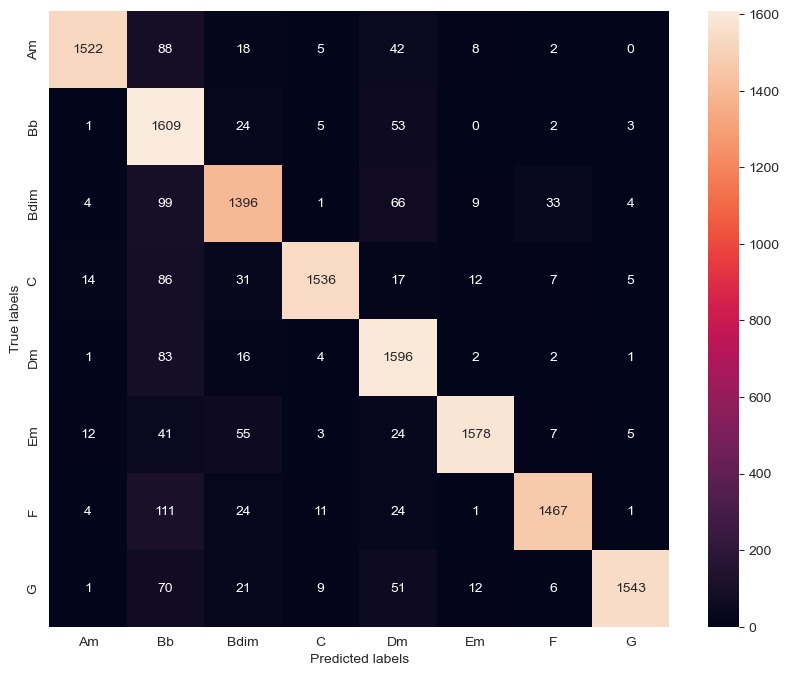

In [67]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='g', xticklabels=chord_labels, yticklabels=chord_labels)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.show()


## Inference


In [129]:
from PIL import Image

def load_spectrogram(file_path):
    image = Image.open(file_path).convert('RGB')
    return transform(image)

Switch to evaluation mode and convert logits to probabilities using softmax


In [130]:
import torch

# Ensure the model is in evaluation mode
model.eval()

# Define the softmax function
softmax = torch.nn.Softmax(dim=1)

Sort spectrograms by file name as it contains its order number. We need to have it ordered to be able to output it aligned with track timeline.

In [139]:
output_dir

PosixPath('data/extracted/Pet-Sematary')

In [131]:
import os

# List all jpg files in the output directory
file_names = [file for file in os.listdir(output_dir) if file.endswith('.jpg')]

# Sort the file names (natural sort or simple alphanumeric sort)
file_names.sort(key=lambda f: int(f.split('_')[-1].split('.')[0]))

spectrograms = [load_spectrogram(os.path.join(output_dir, file)) for file in file_names]

Make predictions for each spectrogram. For each prediction we get top N results. We also map them to labels for output.

In [132]:
index_to_label = {v: k for k,v in label_to_idx.items()}

N = 3  # Number of top predictions

top_labels_all = []
top_confidences_all = []

for spectrogram in spectrograms:
    # make sure spectrograms are on the same device as the model, otherwise there will be input type mismatch
    spectrogram = spectrogram.to(device)
    # Apply the model and get the prediction
    output = model(spectrogram.unsqueeze(0))  # Add batch dimension
    probabilities = softmax(output)

    # Get the top N predictions
    top_probs, top_preds = torch.topk(probabilities, N, dim=1)

    # Convert to labels and confidences
    top_labels = [index_to_label[pred.item()] for pred in top_preds[0]]
    top_confidences = [prob.item() for prob in top_probs[0]]

    top_labels_all.append(top_labels)
    top_confidences_all.append(top_confidences)

## Output

* For each beat, we get top N predictions
* Low confidence predictions with threshold lower than 0.3 will be discarded
* We will consider two adjacents beats at once. First, chords that appear in both beats predictions will be chosen. If there are several such chords, then the chord with the highest average confidence will be chosen.

In [63]:
top_labels_all = [['Am', 'Bdim', 'Dm'], ['Am', 'Bdim', 'F'], ['Am', 'Bdim', 'Em'], ['Am', 'Bdim', 'F'], ['Am', 'F', 'Bdim'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'G'], ['F', 'C', 'Am'], ['C', 'Em', 'Am'], ['C', 'Em', 'Am'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Bdim'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['Em', 'G', 'Bdim'], ['Bdim', 'Em', 'G'], ['Bdim', 'C', 'Em'], ['Bdim', 'Em', 'C'], ['Bdim', 'C', 'Em'], ['C', 'Bdim', 'Em'], ['Bdim', 'C', 'Bb'], ['Bdim', 'Em', 'Am'], ['C', 'Em', 'Bdim'], ['C', 'G', 'Bdim'], ['Bdim', 'Am', 'C'], ['Bdim', 'Em', 'C'], ['Em', 'Bdim', 'C'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Bdim'], ['Em', 'Bdim', 'C'], ['C', 'Em', 'Bdim'], ['C', 'Bdim', 'Em'], ['Bdim', 'C', 'Am'], ['Bdim', 'Em', 'C'], ['Em', 'C', 'Bdim'], ['Em', 'C', 'Bdim'], ['Em', 'C', 'Am'], ['Em', 'C', 'Bdim'], ['C', 'Em', 'Am'], ['Em', 'C', 'Am'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['G', 'Em', 'C'], ['G', 'Em', 'Bdim'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['Em', 'C', 'Bdim'], ['Em', 'Bdim', 'C'], ['C', 'Em', 'Am'], ['Bdim', 'Em', 'C'], ['C', 'Bdim', 'Em'], ['Bdim', 'Em', 'C'], ['C', 'Bdim', 'Am'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Bdim'], ['Bdim', 'Em', 'C'], ['Bdim', 'C', 'Em'], ['Bdim', 'Am', 'Em'], ['C', 'Bdim', 'F'], ['C', 'Em', 'Bdim'], ['Em', 'C', 'Bdim'], ['C', 'Bdim', 'Em'], ['C', 'Bdim', 'Em'], ['C', 'Em', 'Am'], ['Em', 'C', 'Bdim'], ['Em', 'Bdim', 'G'], ['Em', 'Am', 'C'], ['C', 'Em', 'Bdim'], ['Em', 'C', 'Am'], ['C', 'Bdim', 'Em'], ['Em', 'G', 'Bdim'], ['G', 'C', 'Em'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['Em', 'C', 'G'], ['C', 'Em', 'Bdim'], ['C', 'Bdim', 'Em'], ['C', 'Bdim', 'Em'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'G'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Am'], ['F', 'C', 'Bdim'], ['F', 'Bdim', 'Bb'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'Am'], ['Bdim', 'Am', 'Em'], ['G', 'Em', 'Dm'], ['G', 'Em', 'Bdim'], ['G', 'C', 'Em'], ['G', 'C', 'Em'], ['C', 'Em', 'F'], ['C', 'Bdim', 'F'], ['Bdim', 'C', 'Em'], ['Em', 'C', 'Am'], ['Am', 'Bdim', 'C'], ['Am', 'Bdim', 'C'], ['Bdim', 'Em', 'C'], ['Am', 'Bdim', 'C'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'Am'], ['Bdim', 'F', 'Em'], ['G', 'Em', 'Bdim'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['Em', 'G', 'Bdim'], ['C', 'F', 'Em'], ['C', 'F', 'Bdim'], ['C', 'Bdim', 'Am'], ['C', 'Em', 'Am'], ['Am', 'C', 'Em'], ['Am', 'Bdim', 'Em'], ['Am', 'C', 'Em'], ['C', 'Am', 'Bdim'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'G'], ['Bdim', 'F', 'Dm'], ['G', 'C', 'Em'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['C', 'Em', 'Bdim'], ['C', 'Bdim', 'F'], ['C', 'Bdim', 'Em'], ['C', 'Em', 'Bdim'], ['C', 'Bdim', 'Em'], ['Bdim', 'Dm', 'G'], ['C', 'Am', 'Em'], ['G', 'C', 'Bdim'], ['C', 'G', 'Bdim'], ['C', 'Em', 'Am'], ['Bdim', 'Em', 'C'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Am'], ['C', 'Em', 'Am'], ['C', 'Em', 'Bdim'], ['C', 'F', 'Em'], ['C', 'Em', 'G'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Am'], ['C', 'F', 'G'], ['C', 'Em', 'Am'], ['C', 'F', 'Em'], ['C', 'F', 'Em'], ['Em', 'G', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['G', 'Em', 'Dm'], ['G', 'Dm', 'Em'], ['G', 'Em', 'Bdim'], ['G', 'Em', 'Bdim'], ['G', 'Em', 'Dm'], ['Em', 'G', 'C'], ['C', 'Em', 'F'], ['C', 'Em', 'Am'], ['C', 'Em', 'Am'], ['C', 'F', 'Em'], ['Bdim', 'G', 'C'], ['C', 'Em', 'Am'], ['C', 'G', 'Bb'], ['G', 'C', 'Bb'], ['C', 'Bdim', 'F'], ['C', 'Em', 'Bdim'], ['C', 'Em', 'Am'], ['C', 'Em', 'G'], ['C', 'Em', 'Am'], ['C', 'Em', 'Bdim'], ['C', 'F', 'Em'], ['C', 'Em', 'G'], ['C', 'F', 'Em'], ['C', 'Em', 'F'], ['C', 'Em', 'Am'], ['C', 'F', 'Am'], ['C', 'Em', 'F'], ['C', 'Em', 'Am'], ['C', 'F', 'Em'], ['Em', 'C', 'Bdim'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['Em', 'C', 'G'], ['C', 'G', 'F'], ['C', 'Em', 'F'], ['C', 'F', 'G'], ['C', 'Em', 'G'], ['C', 'F', 'Em'], ['C', 'F', 'G'], ['C', 'Em', 'G'], ['C', 'F', 'Em'], ['F', 'Bdim', 'Bb'], ['F', 'Bdim', 'Bb'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Bb'], ['G', 'C', 'Em'], ['G', 'Em', 'Dm'], ['G', 'Em', 'C'], ['G', 'Em', 'Bdim'], ['C', 'Bdim', 'Em'], ['C', 'F', 'Bdim'], ['Bdim', 'C', 'Em'], ['Em', 'C', 'Bdim'], ['Am', 'F', 'Bdim'], ['Am', 'F', 'Bdim'], ['C', 'Am', 'Em'], ['Am', 'Bdim', 'F'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Bb'], ['F', 'Bdim', 'Dm'], ['F', 'Bdim', 'Bb'], ['G', 'C', 'Em'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['C', 'Em', 'F'], ['C', 'Em', 'F'], ['C', 'Bdim', 'Em'], ['C', 'Em', 'Bdim'], ['Am', 'C', 'F'], ['Am', 'C', 'F'], ['C', 'Am', 'Bdim'], ['C', 'Am', 'Bdim'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Am'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'Dm'], ['G', 'Em', 'Bdim'], ['C', 'Em', 'Bdim'], ['C', 'F', 'Em'], ['C', 'Am', 'Em'], ['C', 'F', 'Am'], ['C', 'F', 'Bb'], ['C', 'Bdim', 'Bb'], ['Am', 'C', 'Em'], ['C', 'Em', 'G'], ['Bb', 'C', 'F'], ['F', 'Bb', 'Bdim'], ['F', 'Bdim', 'Bb'], ['F', 'Bdim', 'Am'], ['Em', 'Bdim', 'G'], ['G', 'Em', 'Dm'], ['G', 'Em', 'C'], ['G', 'Em', 'Bdim'], ['G', 'C', 'Bdim'], ['Bdim', 'C', 'Em'], ['Bdim', 'C', 'Em'], ['C', 'Bdim', 'Em'], ['Am', 'Bdim', 'Em'], ['Am', 'Em', 'C'], ['Am', 'Bdim', 'C'], ['Bdim', 'Am', 'C'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Bb'], ['F', 'Am', 'Bdim'], ['F', 'Bdim', 'Am'], ['F', 'Bdim', 'Am'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['C', 'Bdim', 'F'], ['C', 'Bdim', 'Em'], ['Bdim', 'Bb', 'C'], ['C', 'Em', 'Bdim'], ['Am', 'C', 'Bdim'], ['Am', 'Bdim', 'Em'], ['Am', 'Bdim', 'C'], ['C', 'Em', 'Am'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'G'], ['F', 'Bdim', 'C'], ['Bdim', 'C', 'Am'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['G', 'Em', 'C'], ['C', 'G', 'Em'], ['C', 'Em', 'Am'], ['C', 'Em', 'F'], ['C', 'Em', 'Bdim'], ['Em', 'G', 'Bdim'], ['Em', 'G', 'C'], ['Em', 'Bdim', 'G'], ['Bdim', 'Dm', 'G'], ['C', 'Bdim', 'Em'], ['G', 'Em', 'Bdim'], ['Bb', 'Dm', 'Bdim'], ['G', 'C', 'Em'], ['G', 'Em', 'Bdim'], ['Bdim', 'Em', 'G'], ['Em', 'Bdim', 'G'], ['Bdim', 'Dm', 'Em'], ['Bdim', 'Em', 'Dm'], ['Bdim', 'Dm', 'Em'], ['Bdim', 'Dm', 'Em'], ['Bdim', 'Dm', 'Em'], ['Bdim', 'G', 'Em'], ['Dm', 'Bdim', 'Em'], ['Bdim', 'Em', 'Dm'], ['Bdim', 'Em', 'Dm'], ['Bdim', 'Em', 'Dm'], ['Bdim', 'Dm', 'G'], ['Bdim', 'Bb', 'Dm'], ['Dm', 'Bb', 'Bdim'], ['Dm', 'Bb', 'Bdim'], ['Dm', 'Bb', 'G'], ['Dm', 'Bdim', 'Bb'], ['Bdim', 'Dm', 'G'], ['Bb', 'Bdim', 'F'], ['Bb', 'Bdim', 'F'], ['Bb', 'Bdim', 'F'], ['Bb', 'Bdim', 'F']]


In [64]:
top_confidences_all = [[0.9999682903289795, 1.8643555449671112e-05, 3.2012408155424055e-06], [1.0, 3.455216557313179e-08, 6.699992560754708e-09], [0.999994158744812, 5.821518243465107e-06, 2.7442183636594564e-08], [0.9999957084655762, 3.1718900572741404e-06, 5.894535206607543e-07], [0.996033251285553, 0.0033700766507536173, 0.00033036424429155886], [0.999338686466217, 0.0006445908220484853, 7.949475730129052e-06], [0.9945916533470154, 0.005392021033912897, 7.859792276576627e-06], [0.997973620891571, 0.0020230794325470924, 1.527023869130062e-06], [0.6272913813591003, 0.3043990135192871, 0.04177219793200493], [0.9750466346740723, 0.02247261442244053, 0.0012799156829714775], [0.9799456596374512, 0.0181233249604702, 0.0014347000978887081], [0.9843149781227112, 0.012505820952355862, 0.0017757852328941226], [0.6044074296951294, 0.3441586196422577, 0.025835920125246048], [0.9441995620727539, 0.054102543741464615, 0.0014650137163698673], [0.9913933277130127, 0.008495400659739971, 5.8069839724339545e-05], [0.7867040038108826, 0.1636890023946762, 0.04566480219364166], [0.9941316246986389, 0.003130986588075757, 0.001276229741051793], [0.9987307190895081, 0.0008233311236836016, 0.0002383225946687162], [0.9798106551170349, 0.013773615472018719, 0.004361174535006285], [0.9519456624984741, 0.04538328945636749, 0.0022085884120315313], [0.5691701769828796, 0.2751001715660095, 0.14292031526565552], [0.9997846484184265, 0.00010477971954969689, 5.975727617624216e-05], [0.6543551087379456, 0.3314085304737091, 0.006983612198382616], [0.9183700680732727, 0.039693113416433334, 0.01695070043206215], [0.8117281198501587, 0.17549799382686615, 0.006304576527327299], [0.9956146478652954, 0.0031781219877302647, 0.000564676767680794], [0.9698306918144226, 0.026986848562955856, 0.0019182200776413083], [0.5495119690895081, 0.2975173592567444, 0.15160752832889557], [0.4595065414905548, 0.41966503858566284, 0.10330655425786972], [0.6485729217529297, 0.24147413671016693, 0.05936631187796593], [0.9894444346427917, 0.006552147679030895, 0.0023248952347785234], [0.6500663161277771, 0.3117031753063202, 0.02867499552667141], [0.511043131351471, 0.3544650971889496, 0.12504255771636963], [0.5857579708099365, 0.3876490294933319, 0.01662789098918438], [0.9560643434524536, 0.03549935668706894, 0.00722566619515419], [0.8431922793388367, 0.08655642718076706, 0.06916162371635437], [0.5326377153396606, 0.38627225160598755, 0.0675124078989029], [0.887004017829895, 0.10488387197256088, 0.003984498791396618], [0.9892461895942688, 0.0064532943069934845, 0.0034240405075252056], [0.9839189052581787, 0.011592932045459747, 0.0038212700746953487], [0.7103460431098938, 0.27779415249824524, 0.006832411978393793], [0.9969793558120728, 0.0026879908982664347, 0.00030279214843176305], [0.9999082088470459, 8.786487887846306e-05, 1.7475798586019664e-06], [0.999985933303833, 1.3599889825854916e-05, 5.264938067739422e-07], [0.9999780654907227, 1.3904274055676069e-05, 6.6168763623863924e-06], [0.9999154806137085, 7.669557089684531e-05, 4.6908708100090735e-06], [0.9940670728683472, 0.0057904948480427265, 4.7851579438429326e-05], [0.9998214840888977, 0.00017613351519685239, 2.1617177026200807e-06], [0.9999842643737793, 1.0368596122134477e-05, 4.716696366813267e-06], [0.8645802736282349, 0.1193656399846077, 0.010695381090044975], [0.9271736145019531, 0.03787891939282417, 0.03176460042595863], [0.7008058428764343, 0.20126749575138092, 0.06430327147245407], [0.3506266176700592, 0.32889074087142944, 0.3107845187187195], [0.998980700969696, 0.0004488312697503716, 0.00039943927549757063], [0.6890119910240173, 0.2959735691547394, 0.008104474283754826], [0.9668095111846924, 0.017365656793117523, 0.008069752715528011], [0.9703898429870605, 0.013930887915194035, 0.011234861798584461], [0.976175844669342, 0.014190005138516426, 0.004593409597873688], [0.8710477352142334, 0.09678678959608078, 0.02531844936311245], [0.5814170241355896, 0.37136557698249817, 0.037600353360176086], [0.9476297497749329, 0.031296782195568085, 0.010271213948726654], [0.48797622323036194, 0.404583215713501, 0.08252479135990143], [0.6135909557342529, 0.33527249097824097, 0.04324701800942421], [0.49878358840942383, 0.37749791145324707, 0.09768130630254745], [0.7070517539978027, 0.21245932579040527, 0.04308322072029114], [0.8470246195793152, 0.11794738471508026, 0.02404199168086052], [0.9982888102531433, 0.0011083008721470833, 0.000514293962623924], [0.49008262157440186, 0.4707655608654022, 0.026236141100525856], [0.8373445272445679, 0.07679925858974457, 0.045991700142621994], [0.3043397068977356, 0.2815454304218292, 0.23892493546009064], [0.9944522976875305, 0.003944380674511194, 0.0009184483205899596], [0.9406060576438904, 0.04401787742972374, 0.008604601956903934], [0.9776132702827454, 0.013986111618578434, 0.0064584496431052685], [0.9543256163597107, 0.045542631298303604, 7.839324098313227e-05], [0.9999983310699463, 1.4452624554905924e-06, 2.2449815162417508e-07], [0.9999814033508301, 1.2426946341292933e-05, 5.798604888695991e-06], [0.9999419450759888, 5.2803046855842695e-05, 3.5324694636074128e-06], [0.999998927116394, 6.864081001367595e-07, 2.7097357246930187e-07], [0.9999923706054688, 7.193801138782874e-06, 3.7061730040477414e-07], [0.999722421169281, 0.00027655705343931913, 6.646401402576885e-07], [0.9986926913261414, 0.0013055646559223533, 8.21838170850242e-07], [0.9288859963417053, 0.03412935882806778, 0.023054320365190506], [0.991216778755188, 0.004683788400143385, 0.0024813383352011442], [0.7026916742324829, 0.276479572057724, 0.01745053194463253], [0.7035384178161621, 0.17823947966098785, 0.06885126233100891], [0.9445565938949585, 0.04291868582367897, 0.007565007079392672], [0.95402592420578, 0.029281243681907654, 0.008674020878970623], [0.9793339967727661, 0.017194632440805435, 0.002262601861730218], [0.9950878024101257, 0.004441988188773394, 0.00020936981309205294], [0.5125449299812317, 0.24063728749752045, 0.1900920271873474], [0.9993971586227417, 0.000569837458897382, 1.4600190297642257e-05], [0.9997332692146301, 0.0002594258403405547, 3.042648131668102e-06], [0.9060375094413757, 0.09391587972640991, 2.145019971067086e-05], [0.4887462556362152, 0.15781094133853912, 0.11179188638925552], [0.999895453453064, 6.94059272063896e-05, 2.777149529720191e-05], [0.9954828023910522, 0.004496322013437748, 1.0459361874382012e-05], [0.9999991655349731, 7.257220318024338e-07, 6.300016508475892e-08], [0.8788783550262451, 0.10756117850542068, 0.013487119227647781], [0.9999343156814575, 3.8458802009699866e-05, 2.1081865270389244e-05], [0.8135251998901367, 0.15508408844470978, 0.014977676793932915], [0.9715580344200134, 0.008424217812716961, 0.005957786459475756], [0.603216826915741, 0.3429420590400696, 0.038861315697431564], [0.992918074131012, 0.0035752258263528347, 0.002036668360233307], [0.9999474287033081, 3.483154432615265e-05, 8.780494681559503e-06], [0.743022620677948, 0.09871618449687958, 0.07720117270946503], [0.5349262952804565, 0.23664508759975433, 0.19233259558677673], [0.9996801614761353, 0.00031651853350922465, 1.2676354117502342e-06], [0.9996476173400879, 0.00035081608803011477, 8.590626521254308e-07], [0.9999713897705078, 2.708199099288322e-05, 5.604127295555372e-07], [0.9186617136001587, 0.05340556055307388, 0.009616470895707607], [0.9609068036079407, 0.03897818550467491, 5.869078086107038e-05], [0.9933041930198669, 0.006649510934948921, 2.6560846890788525e-05], [0.9999960660934448, 3.820182882918743e-06, 1.4188748309607035e-07], [0.5033649206161499, 0.4964625835418701, 0.00012310812599025667], [0.999968409538269, 2.1361980543588288e-05, 4.218547928758198e-06], [0.9992659687995911, 0.00032914866460487247, 0.00031156602199189365], [0.9380467534065247, 0.03448518365621567, 0.015558553859591484], [0.9999446868896484, 2.727423452597577e-05, 1.9354109099367633e-05], [0.9987897276878357, 0.0004252008511684835, 0.00032814108999446034], [0.99989914894104, 9.309246524935588e-05, 3.2062102945928928e-06], [0.7460533380508423, 0.1551971733570099, 0.05248313769698143], [0.7476543188095093, 0.2431187480688095, 0.005880072247236967], [0.9978261590003967, 0.002109914319589734, 2.5067300157388672e-05], [0.9986470341682434, 0.001349355559796095, 9.884109886115766e-07], [0.994855523109436, 0.005137954372912645, 2.5652336717030266e-06], [0.5064641833305359, 0.49033626914024353, 0.0014917500084266067], [0.9996789693832397, 0.0002000781532842666, 0.00011852553870994598], [0.9999285936355591, 6.871798541396856e-05, 1.737317802508187e-06], [0.9999786615371704, 1.9623856132966466e-05, 1.6088498568933574e-06], [0.98337721824646, 0.016545811668038368, 4.531174636213109e-05], [0.9764577746391296, 0.017790036275982857, 0.0034238353837281466], [0.7300194501876831, 0.2441358119249344, 0.019574763253331184], [0.9716930985450745, 0.015182494185864925, 0.011587828397750854], [0.9452018737792969, 0.050883688032627106, 0.0020221970044076443], [0.9847267866134644, 0.0078371437266469, 0.004890878684818745], [0.9996175765991211, 0.0001819831959437579, 0.00011837897909572348], [0.43189191818237305, 0.28307318687438965, 0.20540855824947357], [0.9304385781288147, 0.03202911466360092, 0.030238788574934006], [0.9883823990821838, 0.005185862071812153, 0.0034259986132383347], [0.9980447292327881, 0.001662085298448801, 0.0001570047315908596], [0.9949776530265808, 0.004096461925655603, 0.0004447827232070267], [0.9979695677757263, 0.001321193529292941, 0.0004856236628256738], [0.9007982611656189, 0.09483161568641663, 0.0028072947170585394], [0.9998691082000732, 0.0001289557112613693, 1.2917848835058976e-06], [0.9990997314453125, 0.0008591083460487425, 3.187442052876577e-05], [0.998526930809021, 0.0012707356363534927, 9.60098986979574e-05], [0.9999724626541138, 2.2882426492287777e-05, 3.6746482692251448e-06], [0.9999532699584961, 3.997770181740634e-05, 2.503400537534617e-06], [0.9964660406112671, 0.0033734275493770838, 0.00011091538181062788], [0.9999134540557861, 5.9944326494587585e-05, 1.1792306395363994e-05], [0.9999948740005493, 4.190838353679283e-06, 3.1657813792662637e-07], [0.9999881982803345, 1.0982075764331967e-05, 4.825127462027012e-07], [0.9994569420814514, 0.0002253629791084677, 0.00021699770877603441], [0.999931812286377, 6.006577314110473e-05, 5.493873686646111e-06], [0.7833970785140991, 0.2159174084663391, 0.00032918204669840634], [0.9999308586120605, 6.315578502835706e-05, 2.8933898192917695e-06], [0.9999995231628418, 2.7510762379279186e-07, 1.2205045152313687e-07], [0.9999792575836182, 1.744718974805437e-05, 1.9688154679897707e-06], [0.999983549118042, 1.0508363629924133e-05, 5.2545951803040225e-06], [0.9954864382743835, 0.004499366972595453, 9.51356105360901e-06], [0.9820919632911682, 0.017816709354519844, 7.879801705712453e-05], [0.9997926354408264, 0.0002030217001447454, 2.7023245365853654e-06], [0.4741944968700409, 0.4560065269470215, 0.06560687720775604], [0.9999963045120239, 1.7420826452507754e-06, 1.2962736946064979e-06], [0.9998210072517395, 0.00017555270460434258, 1.9423405319685116e-06], [0.9999874830245972, 7.861062840675004e-06, 3.2047969398263376e-06], [0.9999990463256836, 3.316730783353705e-07, 2.9521453370762174e-07], [0.7386753559112549, 0.1648339480161667, 0.08197995275259018], [0.9049198627471924, 0.09238047897815704, 0.00209709326736629], [0.8449522852897644, 0.154887393116951, 7.90187405073084e-05], [0.821611225605011, 0.16601550579071045, 0.0054582031443715096], [0.9752708673477173, 0.018952922895550728, 0.00398659473285079], [0.5940794348716736, 0.37055811285972595, 0.031184878200292587], [0.98052978515625, 0.009462863206863403, 0.00413917563855648], [0.9934173822402954, 0.0027806912548840046, 0.0021850138437002897], [0.9999998807907104, 1.5114881080080522e-07, 4.51726656081064e-09], [0.9998958110809326, 9.615334420232102e-05, 3.587740593502531e-06], [0.9999774694442749, 1.889993654913269e-05, 2.4296191440953407e-06], [0.9999790191650391, 1.7374659364577383e-05, 1.719084366413881e-06], [0.9998055100440979, 0.0001213327850564383, 3.539930548868142e-05], [0.9998244643211365, 5.4621104936813936e-05, 5.320834679878317e-05], [0.9935599565505981, 0.003761898260563612, 0.002301660366356373], [0.9999904632568359, 4.1117655200650916e-06, 2.101492782458081e-06], [0.9999983310699463, 9.244265015695419e-07, 5.155685016688949e-07], [0.9964820146560669, 0.0029184482991695404, 0.000502482638694346], [0.9959053993225098, 0.003125076415017247, 0.0005476100486703217], [0.6993145942687988, 0.21558307111263275, 0.07765020430088043], [0.9999849796295166, 1.3582561223302037e-05, 1.0498775964151719e-06], [0.9999821186065674, 7.49585296944133e-06, 6.446889983635629e-06], [0.9999673366546631, 3.152354111080058e-05, 9.065408335118263e-07], [0.9998838901519775, 9.939369920175523e-05, 1.4102013665251434e-05], [0.9999808073043823, 1.4909041965438519e-05, 3.893947450706037e-06], [0.9999731779098511, 2.672110167623032e-05, 1.0886373758012269e-07], [0.99989914894104, 0.00010001584450947121, 3.6633724675994017e-07], [0.7615629434585571, 0.12061304599046707, 0.1122642308473587], [0.9999469518661499, 2.290170596097596e-05, 2.133584894181695e-05], [0.9999536275863647, 3.3840817195596173e-05, 5.629388397210278e-06], [0.9999775886535645, 1.498258461651858e-05, 2.33634432333929e-06], [0.9998406171798706, 8.20068598841317e-05, 2.1742838725913316e-05], [0.9999775886535645, 1.9925284505006857e-05, 1.6333253824996063e-06], [0.9999867677688599, 1.2229147614561953e-05, 3.7982474054842896e-07], [0.9999380111694336, 4.7489869757555425e-05, 4.67578183815931e-06], [0.9962599277496338, 0.0019146109698340297, 0.001233587390743196], [0.999631404876709, 0.00024834583746269345, 8.79294821061194e-05], [0.9998788833618164, 0.00010413209383841604, 1.282514313061256e-05], [0.9999786615371704, 2.0428071366040967e-05, 3.5735769188249833e-07], [0.9529814720153809, 0.027857903391122818, 0.01726558990776539], [0.9998537302017212, 9.291058813687414e-05, 3.887150887749158e-05], [0.9987010955810547, 0.0012926117051392794, 2.928576122940285e-06], [0.9966879487037659, 0.003281800774857402, 1.2925477676617447e-05], [0.6096164584159851, 0.3843982219696045, 0.004666763823479414], [0.9972255229949951, 0.0013176382053643465, 0.0009234294993802905], [0.9993064403533936, 0.0005462811095640063, 6.455084076151252e-05], [0.6977244019508362, 0.2039133757352829, 0.07950986176729202], [0.8659047484397888, 0.1251676231622696, 0.007765396032482386], [0.9927734732627869, 0.005258446559309959, 0.0010242199059575796], [0.9888631105422974, 0.005666007287800312, 0.004315256606787443], [0.9864954948425293, 0.006713157054036856, 0.005839298479259014], [0.5640131831169128, 0.2091425508260727, 0.1761167198419571], [0.9998401403427124, 0.00014424508844967932, 1.0034541446657386e-05], [0.999742329120636, 0.00014145993918646127, 5.632959437207319e-05], [0.9998736381530762, 0.0001097864587791264, 8.273466846731026e-06], [0.9999392032623291, 3.370605190866627e-05, 2.4466662580380216e-05], [0.9999701976776123, 2.228538505733013e-05, 7.290498160728021e-06], [0.9975659847259521, 0.0024096565321087837, 2.2512042050948367e-05], [0.9998390674591064, 0.00016009151295293123, 6.862800319140661e-07], [0.9999871253967285, 1.1797516890510451e-05, 9.718463616081863e-07], [0.9977245926856995, 0.0013269289629533887, 0.0004453153524082154], [0.9999908208847046, 5.119036813994171e-06, 1.925604919961188e-06], [0.9836596250534058, 0.008185140788555145, 0.006379039958119392], [0.9966235160827637, 0.003089041681960225, 0.00019662755948957056], [0.9999604225158691, 2.42446840275079e-05, 6.174454483698355e-06], [0.9998886585235596, 0.00010057050531031564, 7.856216143409256e-06], [0.711729109287262, 0.2645765244960785, 0.015884701162576675], [0.6665201187133789, 0.296831876039505, 0.023381562903523445], [0.9975065588951111, 0.0013148339930921793, 0.0006197791662998497], [0.999321460723877, 0.0006621770444326103, 1.1776831343013328e-05], [0.999496340751648, 0.0005011063767597079, 8.888303568710398e-07], [0.9986032843589783, 0.0013573996257036924, 2.1570042008534074e-05], [0.971777617931366, 0.015478203073143959, 0.012006908655166626], [0.9997707009315491, 0.00022597401402890682, 2.5645529149187496e-06], [0.9999861717224121, 7.231781637528911e-06, 3.623942802732927e-06], [0.9910498857498169, 0.008872630074620247, 4.319574873079546e-05], [0.9866307377815247, 0.011831294745206833, 0.0010140928206965327], [0.9989680051803589, 0.0007764908368699253, 0.00013273331569507718], [0.9998151659965515, 8.4216873801779e-05, 4.11121582146734e-05], [0.9999034404754639, 4.305475522414781e-05, 3.059609298361465e-05], [0.9789886474609375, 0.009662800468504429, 0.009360979311168194], [0.8864584565162659, 0.10013831406831741, 0.007433895952999592], [0.6280955672264099, 0.3704339861869812, 0.0011262254556640983], [0.9938799142837524, 0.004713487811386585, 0.001068966812454164], [0.8007425665855408, 0.09967989474534988, 0.09792767465114594], [0.9974430799484253, 0.0024963892064988613, 4.4344327761791646e-05], [0.9996411800384521, 0.00027775514172390103, 7.273285882547498e-05], [0.9998513460159302, 8.433719631284475e-05, 5.4630912927677855e-05], [0.31390178203582764, 0.17376765608787537, 0.17163951694965363], [0.9998881816864014, 9.259278158424422e-05, 1.3776344530924689e-05], [0.9995477795600891, 0.0004429153341334313, 8.669404451211449e-06], [0.9925635457038879, 0.007354766130447388, 5.925211007706821e-05], [0.7599515318870544, 0.1831102967262268, 0.03099946118891239], [0.712683916091919, 0.24608266353607178, 0.03856467455625534], [0.9989421963691711, 0.000615274824667722, 0.0003877909330185503], [0.992046594619751, 0.006785015109926462, 0.0005954238004051149], [0.9493616819381714, 0.032586757093667984, 0.01626000553369522], [0.9843398332595825, 0.011758191511034966, 0.0026747342199087143], [0.831732451915741, 0.12775658071041107, 0.02394910156726837], [0.612220287322998, 0.23961441218852997, 0.10365147143602371], [0.3226698040962219, 0.25170812010765076, 0.2124861478805542], [0.9996200799942017, 0.0002749926643446088, 5.154925383976661e-05], [0.9997443556785583, 0.00014036378706805408, 0.00010337563435314223], [0.9999741315841675, 2.2243219063966535e-05, 1.923961235661409e-06], [0.979123592376709, 0.008662446402013302, 0.004584925714880228], [0.9960790276527405, 0.003912543412297964, 6.669788035651436e-06], [0.999998927116394, 7.773542733957584e-07, 2.2536812593898503e-07], [0.9998995065689087, 9.568570385454223e-05, 4.014688329334604e-06], [0.9996335506439209, 0.0002101939171552658, 0.00015203173097688705], [0.9822894930839539, 0.01542542316019535, 0.0016059944173321128], [0.693886399269104, 0.28992515802383423, 0.00942250620573759], [0.9998941421508789, 4.394545976538211e-05, 3.043014476133976e-05], [0.49941495060920715, 0.35422784090042114, 0.14315196871757507], [0.9997703433036804, 8.784279634710401e-05, 8.383928070543334e-05], [0.9997788071632385, 0.00011388120765332133, 6.660851067863405e-05], [0.8462061285972595, 0.12426236271858215, 0.023561649024486542], [0.9988816380500793, 0.00047933257883414626, 0.00044621844426728785], [0.9996684789657593, 0.00033022311981767416, 7.591061148559675e-07], [0.9987527132034302, 0.0012195659801363945, 1.5787723896210082e-05], [0.964218258857727, 0.03554515913128853, 0.0001001095661194995], [0.4095606505870819, 0.37992218136787415, 0.16034407913684845], [0.9941431879997253, 0.005772593431174755, 7.69225152907893e-05], [0.9999961853027344, 3.466445150479558e-06, 4.143724083860434e-07], [0.9999960660934448, 3.4904519452538807e-06, 4.289749711006152e-07], [0.999649167060852, 0.00031789482454769313, 3.0700855859322473e-05], [0.9970003962516785, 0.0025398838333785534, 0.0004267787153366953], [0.9996004700660706, 0.00036368309520184994, 1.9653472918435e-05], [0.9999583959579468, 2.3534816136816517e-05, 5.617589977191528e-06], [0.9501614570617676, 0.04454915225505829, 0.003335203742608428], [0.7955237627029419, 0.19141137599945068, 0.00745105417445302], [0.6241260766983032, 0.3612905442714691, 0.008458167314529419], [0.9993450045585632, 0.0005250161048024893, 8.619279833510518e-05], [0.41136863827705383, 0.3140563368797302, 0.16871537268161774], [0.49742746353149414, 0.2267232984304428, 0.21307823061943054], [0.7615517973899841, 0.07561306655406952, 0.06575965136289597], [0.26011213660240173, 0.2066490799188614, 0.19491004943847656], [0.44445884227752686, 0.2671762704849243, 0.12032778561115265], [0.3882315754890442, 0.31198209524154663, 0.1351836919784546], [0.4468923807144165, 0.16421809792518616, 0.14458349347114563], [0.6315782070159912, 0.3345934748649597, 0.011845188215374947], [0.44800952076911926, 0.26503363251686096, 0.15314485132694244], [0.3383553624153137, 0.23044800758361816, 0.18912285566329956], [0.4080848693847656, 0.1641187071800232, 0.15442383289337158], [0.38016393780708313, 0.19971631467342377, 0.15833206474781036], [0.2206835001707077, 0.2018560916185379, 0.12496840208768845], [0.2801177203655243, 0.2072150856256485, 0.18329574167728424], [0.43531984090805054, 0.1366548240184784, 0.11414725333452225], [0.30206921696662903, 0.28847068548202515, 0.1359184980392456], [0.4797341227531433, 0.2218017578125, 0.08892729133367538], [0.6357342600822449, 0.15462741255760193, 0.07498902082443237], [0.3285396695137024, 0.27238789200782776, 0.11400305479764938], [0.24712584912776947, 0.24474768340587616, 0.2061963975429535], [0.7120377421379089, 0.1398232877254486, 0.0379510335624218], [0.662039041519165, 0.12588131427764893, 0.07228903472423553], [0.8395115733146667, 0.04889485985040665, 0.04049321636557579], [0.2740205228328705, 0.21651780605316162, 0.1808648407459259], [0.5092427134513855, 0.18887165188789368, 0.11036237329244614], [0.16399115324020386, 0.15866346657276154, 0.13897652924060822], [0.16320589184761047, 0.15487153828144073, 0.14323469996452332], [0.16320589184761047, 0.15487153828144073, 0.14323469996452332], [0.16320589184761047, 0.15487153828144073, 0.14323469996452332]]


In [133]:
for file, labels, confidences in zip(file_names[:20], top_labels_all[:20], top_confidences_all[:20]):
    print(f"{file}:")
    for label, confidence in zip(labels, confidences):
        print(f"  {label}: {confidence:.4f}")

spectrogram_0.jpg:
  Am: 1.0000
  Bdim: 0.0000
  Dm: 0.0000
spectrogram_1.jpg:
  Am: 1.0000
  Bdim: 0.0000
  F: 0.0000
spectrogram_2.jpg:
  Am: 1.0000
  Bdim: 0.0000
  Em: 0.0000
spectrogram_3.jpg:
  Am: 1.0000
  Bdim: 0.0000
  F: 0.0000
spectrogram_4.jpg:
  Am: 0.9959
  F: 0.0034
  Bdim: 0.0004
spectrogram_5.jpg:
  F: 0.9993
  Bdim: 0.0007
  Am: 0.0000
spectrogram_6.jpg:
  F: 0.9939
  Bdim: 0.0061
  G: 0.0000
spectrogram_7.jpg:
  F: 0.9978
  Bdim: 0.0022
  G: 0.0000
spectrogram_8.jpg:
  F: 0.6356
  C: 0.2985
  Am: 0.0403
spectrogram_9.jpg:
  C: 0.9742
  Em: 0.0235
  Am: 0.0012
spectrogram_10.jpg:
  C: 0.9799
  Em: 0.0183
  Am: 0.0013
spectrogram_11.jpg:
  C: 0.9856
  Em: 0.0116
  Bdim: 0.0016
spectrogram_12.jpg:
  C: 0.6276
  Em: 0.3257
  Bdim: 0.0233
spectrogram_13.jpg:
  G: 0.9381
  Em: 0.0602
  C: 0.0015
spectrogram_14.jpg:
  G: 0.9910
  Em: 0.0089
  C: 0.0001
spectrogram_15.jpg:
  Em: 0.7964
  G: 0.1553
  Bdim: 0.0444
spectrogram_16.jpg:
  Bdim: 0.9942
  Em: 0.0031
  G: 0.0013
spe

In [82]:
def map_label_to_confidence(labels, confidences):
    result = {}
    for label, confidence in zip(labels, confidences):
        result[label] = confidence

    return result

In [86]:
def get_with_max_confidence(common_labels, prev_labels, prev_confidences, labels, confidences):
    prev_labels_to_confidence = map_label_to_confidence(prev_labels, prev_confidences)
    labels_to_confidence = map_label_to_confidence(labels, confidences)

    highest_conf_label = list(common_labels)[0]
    highest_confidence = 0

    for label in common_labels:
        avg_conf = (prev_labels_to_confidence[label] + labels_to_confidence[label]) / 2

        if avg_conf > highest_confidence:
            highest_confidence = avg_conf
            highest_conf_label = label

    return highest_conf_label, highest_confidence



In [134]:
chord_predictions = []

for i in range(1, len(top_labels_all), 2):
    prev_labels = top_labels_all[i - 1]
    labels = top_labels_all[i]

    prev_confidences = top_confidences_all[i - 1]
    confidences = top_confidences_all[i]

    common_labels = set(prev_labels).intersection(labels)

    if len(common_labels) == 1:
        common_label = list(common_labels)[0]

        prev_index = prev_labels.index(common_label)
        index = labels.index(common_label)

        avg_confidence = (prev_confidences[prev_index] + confidences[index]) / 2

        chord_predictions.append((common_label, avg_confidence))
    elif len(common_labels) > 1:
        chord_predictions.append(get_with_max_confidence(common_labels, prev_labels, prev_confidences, labels, confidences))
    else:
        combined = list(zip(prev_labels + labels, prev_confidences + confidences))
        combined_sorted = sorted(combined, key=lambda x: x[1], reverse=True)

        chord_predictions.append(combined_sorted[0])

In [135]:
chord_predictions

[('Am', 0.9999858140945435),
 ('Am', 0.9999956488609314),
 ('F', 0.5013520735083148),
 ('F', 0.9958430826663971),
 ('C', 0.6363391131162643),
 ('C', 0.9827390909194946),
 ('C', 0.31457390810828656),
 ('G', 0.5731568485498428),
 ('Bdim', 0.9964280724525452),
 ('Bdim', 0.9607214629650116),
 ('Bdim', 0.6247877404093742),
 ('Bdim', 0.3463351624086499),
 ('Bdim', 0.5008135205134749),
 ('Bdim', 0.6306758970022202),
 ('C', 0.5615904033184052),
 ('Em', 0.6566230803728104),
 ('C', 0.4761989116668701),
 ('Bdim', 0.5054807886481285),
 ('Em', 0.7095483541488647),
 ('Em', 0.5012440257705748),
 ('Em', 0.36519480496644974),
 ('G', 0.9999555945396423),
 ('G', 0.9999484419822693),
 ('G', 0.996751606464386),
 ('Em', 0.4244444567902974),
 ('Em', 0.5611974820494652),
 ('C', 0.6543804258108139),
 ('C', 0.4877354819327593),
 ('C', 0.9734614491462708),
 ('Bdim', 0.7377640306949615),
 ('Bdim', 0.6803880482912064),
 ('C', 0.48855167627334595),
 ('C', 0.7806870341300964),
 ('C', 0.7330265492200851),
 ('Em', 0.5

In [136]:
from IPython.display import display, HTML

def display_chords(chord_predictions):
    # Define a color scheme for each chord
    chord_colors = {
        "Am": "#FFD700",  # Gold
        "Bb": "#FF4500",  # OrangeRed
        "Bdim": "#1E90FF",  # DodgerBlue
        "C": "#32CD32",  # LimeGreen
        "Dm": "#BA55D3",  # MediumOrchid
        "Em": "#FF69B4",  # HotPink
        "F": "#00CED1",  # DarkTurquoise
        "G": "#FFA500",  # Orange
    }

    # Start the HTML string for output
    output = "<div style='display: flex; flex-wrap: wrap;'>"

    # Counter to keep track of chords per line
    chords_per_line = 0

    for i, (chord, conf) in enumerate(chord_predictions, start=1):
        # Get the color for the current chord
        color = chord_colors.get(chord, "grey")  # Default to grey if chord not found

        # Create a div for the chord with the specific background color and white text for contrast
        output += f"<div style='color: white; margin: 5px; padding: 10px; background-color: {color}; width: 100px; text-align: center;'>{chord}</div>"

        # Increment the counter
        chords_per_line += 1

        # Check if we've reached 4 chords or the end of the list, then reset counter and add a line break
        if chords_per_line == 4 or i == len(chord_predictions):
            output += "<div style='flex-basis: 100%; height: 0;'></div>"  # This creates a line break in flexbox
            chords_per_line = 0

    # Close the HTML string
    output += "</div>"

    # Display the HTML in the Jupyter Notebook
    display(HTML(output))


In [138]:
display_chords(chord_predictions)